<a href="https://colab.research.google.com/github/ujjwalkp/Emotion-Detection-using-Keras/blob/master/shinkansen_hackathon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pandas_profiling

In [5]:
import plotly.express as px 
import os
import pandas as pd
import pandas_profiling
from IPython.display import display
from sklearn.impute import SimpleImputer
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from scipy.stats import zscore
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
import pickle   

In [6]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [7]:
%cd /content/gdrive/MyDrive/Colab Notebooks/shinkansen-testbed/data_set

/content/gdrive/MyDrive/Colab Notebooks/shinkansen-testbed/data_set


In [8]:
survey_df = pd.read_csv("Surveydata_train.csv")
survey_df_test = pd.read_csv("Surveydata_test .csv")

In [7]:
display(pandas_profiling.ProfileReport(survey_df))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
travel_df = pd.read_csv("Traveldata_train.csv")
travel_df_test = pd.read_csv("Traveldata_test.csv")


In [9]:
display(pandas_profiling.ProfileReport(travel_df))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
merged_df = pd.merge(survey_df, travel_df, on= 'ID')
merged_df_test = pd.merge(survey_df_test, travel_df_test, on= 'ID')

In [11]:
display(pandas_profiling.ProfileReport(merged_df))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
merged_df.isnull().sum()

ID                            0
Overall_Experience            0
Seat_comfort                 61
Seat_Class                    0
Arrival_time_convenient    8930
Catering                   8741
Platform_location            30
Onboardwifi_service          30
Onboard_entertainment        18
Online_support               91
Onlinebooking_Ease           73
Onboard_service            7601
Leg_room                     90
Baggage_handling            142
Checkin_service              77
Cleanliness                   6
Online_boarding               6
Gender                       77
CustomerType               8951
Age                          33
TypeTravel                 9226
Travel_Class                  0
Travel_Distance               0
DepartureDelay_in_Mins       57
ArrivalDelay_in_Mins        357
dtype: int64

In [13]:
merged_df_test.isnull().sum()

ID                            0
Seat_comfort                 22
Seat_Class                    0
Arrival_time_convenient    3325
Catering                   3357
Platform_location            12
Onboardwifi_service          12
Onboard_entertainment         8
Online_support               26
Onlinebooking_Ease           18
Onboard_service            2872
Leg_room                     25
Baggage_handling             40
Checkin_service              22
Cleanliness                   2
Online_boarding               2
Gender                       30
CustomerType               3383
Age                          11
TypeTravel                 3448
Travel_Class                  0
Travel_Distance               0
DepartureDelay_in_Mins       29
ArrivalDelay_in_Mins        123
dtype: int64

In [11]:
missing_cat_features = ['Seat_comfort', 'Arrival_time_convenient', 'Catering', 'Platform_location', 'Onboardwifi_service', 'Onboard_entertainment', 'Online_support', 'Onlinebooking_Ease', 'Onboard_service', 'Leg_room', 'Baggage_handling', 'Checkin_service', 'Cleanliness', 'Online_boarding','Gender', 'CustomerType','TypeTravel', 'Travel_Class']
missing_val_fatures = ['Age', 'DepartureDelay_in_Mins', 'ArrivalDelay_in_Mins']

In [12]:
cat_imputer = SimpleImputer(strategy='most_frequent')
val_imputer =  SimpleImputer(strategy='mean')

In [13]:
merged_df[missing_cat_features] = cat_imputer.fit_transform(merged_df[missing_cat_features])
merged_df[missing_val_fatures] = val_imputer.fit_transform(merged_df[missing_val_fatures])

In [17]:
merged_df.isnull().sum()

ID                         0
Overall_Experience         0
Seat_comfort               0
Seat_Class                 0
Arrival_time_convenient    0
Catering                   0
Platform_location          0
Onboardwifi_service        0
Onboard_entertainment      0
Online_support             0
Onlinebooking_Ease         0
Onboard_service            0
Leg_room                   0
Baggage_handling           0
Checkin_service            0
Cleanliness                0
Online_boarding            0
Gender                     0
CustomerType               0
Age                        0
TypeTravel                 0
Travel_Class               0
Travel_Distance            0
DepartureDelay_in_Mins     0
ArrivalDelay_in_Mins       0
dtype: int64

In [14]:
merged_df_test[missing_cat_features] = cat_imputer.fit_transform(merged_df_test[missing_cat_features])
merged_df_test[missing_val_fatures] = val_imputer.fit_transform(merged_df_test[missing_val_fatures])

In [19]:
merged_df.isnull().sum()

ID                         0
Overall_Experience         0
Seat_comfort               0
Seat_Class                 0
Arrival_time_convenient    0
Catering                   0
Platform_location          0
Onboardwifi_service        0
Onboard_entertainment      0
Online_support             0
Onlinebooking_Ease         0
Onboard_service            0
Leg_room                   0
Baggage_handling           0
Checkin_service            0
Cleanliness                0
Online_boarding            0
Gender                     0
CustomerType               0
Age                        0
TypeTravel                 0
Travel_Class               0
Travel_Distance            0
DepartureDelay_in_Mins     0
ArrivalDelay_in_Mins       0
dtype: int64

In [15]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94379 entries, 0 to 94378
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       94379 non-null  int64  
 1   Overall_Experience       94379 non-null  int64  
 2   Seat_comfort             94379 non-null  object 
 3   Seat_Class               94379 non-null  object 
 4   Arrival_time_convenient  94379 non-null  object 
 5   Catering                 94379 non-null  object 
 6   Platform_location        94379 non-null  object 
 7   Onboardwifi_service      94379 non-null  object 
 8   Onboard_entertainment    94379 non-null  object 
 9   Online_support           94379 non-null  object 
 10  Onlinebooking_Ease       94379 non-null  object 
 11  Onboard_service          94379 non-null  object 
 12  Leg_room                 94379 non-null  object 
 13  Baggage_handling         94379 non-null  object 
 14  Checkin_service       

In [16]:
merged_df['Seat_comfort'].value_counts()

acceptable          21219
need improvement    20946
good                20595
poor                15185
excellent           12971
extremely poor       3463
Name: Seat_comfort, dtype: int64

In [17]:
merged_df_orig = merged_df.copy()

cat_mapping = {}

for col in merged_df.columns:
    if merged_df[col].dtype == 'object' or merged_df[col].dtype.name == 'category':
        categories = merged_df[col].unique().tolist()
        cat_mapping[col] = {category: i for i, category in enumerate(categories)}
        merged_df[col].replace(cat_mapping[col], inplace=True)
        print(f"{col}: {cat_mapping[col]}")

Seat_comfort: {'need improvement': 0, 'poor': 1, 'acceptable': 2, 'good': 3, 'excellent': 4, 'extremely poor': 5}
Seat_Class: {'Green Car': 0, 'Ordinary': 1}
Arrival_time_convenient: {'excellent': 0, 'need improvement': 1, 'acceptable': 2, 'good': 3, 'poor': 4, 'extremely poor': 5}
Catering: {'excellent': 0, 'poor': 1, 'need improvement': 2, 'acceptable': 3, 'good': 4, 'extremely poor': 5}
Platform_location: {'very convinient': 0, 'need improvement': 1, 'manageable': 2, 'Inconvinient': 3, 'Convinient': 4, 'very inconvinient': 5}
Onboardwifi_service: {'good': 0, 'need improvement': 1, 'acceptable': 2, 'excellent': 3, 'poor': 4, 'extremely poor': 5}
Onboard_entertainment: {'need improvement': 0, 'poor': 1, 'good': 2, 'excellent': 3, 'acceptable': 4, 'extremely poor': 5}
Online_support: {'acceptable': 0, 'good': 1, 'excellent': 2, 'poor': 3, 'need improvement': 4, 'extremely poor': 5}
Onlinebooking_Ease: {'need improvement': 0, 'good': 1, 'excellent': 2, 'acceptable': 3, 'poor': 4, 'extre

In [18]:
merged_df_test_orig = merged_df_test.copy()

for col in merged_df_test.columns:
    if col in cat_mapping:
        merged_df_test[col].replace(cat_mapping[col], inplace=True)

In [19]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94379 entries, 0 to 94378
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       94379 non-null  int64  
 1   Overall_Experience       94379 non-null  int64  
 2   Seat_comfort             94379 non-null  int64  
 3   Seat_Class               94379 non-null  int64  
 4   Arrival_time_convenient  94379 non-null  int64  
 5   Catering                 94379 non-null  int64  
 6   Platform_location        94379 non-null  int64  
 7   Onboardwifi_service      94379 non-null  int64  
 8   Onboard_entertainment    94379 non-null  int64  
 9   Online_support           94379 non-null  int64  
 10  Onlinebooking_Ease       94379 non-null  int64  
 11  Onboard_service          94379 non-null  int64  
 12  Leg_room                 94379 non-null  int64  
 13  Baggage_handling         94379 non-null  int64  
 14  Checkin_service       

In [20]:
merged_df['Seat_comfort'].value_counts()

2    21219
0    20946
3    20595
1    15185
4    12971
5     3463
Name: Seat_comfort, dtype: int64

In [26]:
#sns.pairplot(merged_df.iloc[:,1:29], corner= True, hue = 'Overall_Experience')
#plt.show()

In [27]:
display(pandas_profiling.ProfileReport(merged_df))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [21]:
x = merged_df.drop(['ID', 'Overall_Experience', 'DepartureDelay_in_Mins', 'ArrivalDelay_in_Mins'], axis = 1)
y = merged_df['Overall_Experience']
display(x.head())

x_test_given = merged_df_test.drop(['ID', 'DepartureDelay_in_Mins', 'ArrivalDelay_in_Mins'], axis = 1)
#y_test_given = merged_df_test['Overall_Experience']
display(x_test_given.head())


,Seat_comfort,Seat_Class,Arrival_time_convenient,Catering,Platform_location,Onboardwifi_service,Onboard_entertainment,Online_support,Onlinebooking_Ease,Onboard_service,...,Baggage_handling,Checkin_service,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Travel_Class,Travel_Distance
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,52.0,0,0,272
1,1,1,0,1,1,0,1,1,1,1,...,1,1,1,1,1,0,48.0,1,1,2200
2,0,0,1,2,1,1,2,2,2,1,...,2,0,2,2,0,0,43.0,0,0,1061
3,2,1,1,3,1,2,0,0,3,2,...,3,0,3,3,0,0,44.0,0,0,780
4,2,1,2,3,2,1,2,2,1,3,...,4,0,1,1,0,0,50.0,0,0,1981


,Seat_comfort,Seat_Class,Arrival_time_convenient,Catering,Platform_location,Onboardwifi_service,Onboard_entertainment,Online_support,Onlinebooking_Ease,Onboard_service,...,Baggage_handling,Checkin_service,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Travel_Class,Travel_Distance
0,2,0,2,3,2,1,3,1,2,1,...,2,0,2,0,0,0,36.0,0,0,532
1,5,1,3,1,2,2,1,0,3,1,...,4,2,2,3,0,1,21.0,0,0,1425
2,4,1,0,0,0,3,3,2,0,0,...,0,0,0,2,1,0,60.0,0,0,2832
3,2,0,0,3,0,4,4,2,4,2,...,2,3,2,0,0,0,29.0,1,1,1352
4,4,1,5,0,1,3,3,2,2,3,...,2,3,2,2,1,1,18.0,0,0,1610


In [22]:
df_scaled = x.apply(zscore)
display(df_scaled.head())


df_test = x_test_given.apply(zscore)
display(df_test.head())

,Seat_comfort,Seat_Class,Arrival_time_convenient,Catering,Platform_location,Onboardwifi_service,Onboard_entertainment,Online_support,Onlinebooking_Ease,Onboard_service,...,Baggage_handling,Checkin_service,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Travel_Class,Travel_Distance
0,-1.363906,-0.994811,-1.492593,-1.665940,-1.578543,-1.310234,-1.711257,-1.384801,-1.464730,-1.739435,...,-2.037594,-1.288902,-1.613878,-1.618266,-0.985222,-0.445082,0.832369,-0.625411,-1.046703,-1.660469
1,-0.681407,1.005216,-1.492593,-0.960453,-0.845522,-1.310234,-0.961670,-0.580185,-0.635915,-0.906679,...,-1.272699,-0.557421,-0.676219,-0.815740,1.014999,-0.445082,0.567712,1.598950,0.955380,0.215099
2,-1.363906,-0.994811,-0.812997,-0.254966,-0.845522,-0.565998,-0.212083,0.224430,0.192900,-0.906679,...,-0.507804,-1.288902,0.261441,-0.013214,-0.985222,-0.445082,0.236891,-0.625411,-1.046703,-0.892926
3,0.001092,1.005216,-0.812997,0.450521,-0.845522,0.178239,-1.711257,-1.384801,1.021715,-0.073924,...,0.257091,-1.288902,1.199100,0.789312,-0.985222,-0.445082,0.303056,-0.625411,-1.046703,-1.166284
4,0.001092,1.005216,-0.133400,0.450521,-0.112502,-0.565998,-0.212083,0.224430,-0.635915,0.758832,...,1.021986,-1.288902,-0.676219,-0.815740,-0.985222,-0.445082,0.700041,-0.625411,-1.046703,0.002054


,Seat_comfort,Seat_Class,Arrival_time_convenient,Catering,Platform_location,Onboardwifi_service,Onboard_entertainment,Online_support,Onlinebooking_Ease,Onboard_service,...,Baggage_handling,Checkin_service,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Travel_Class,Travel_Distance
0,-0.001650,-1.003320,-0.135546,0.445084,-0.111028,-0.555566,0.530772,-0.577263,0.200834,-0.902545,...,-0.511724,-1.289361,0.259680,-1.614447,-0.983397,-0.444331,-0.227750,-0.618071,-1.038491,-1.420638
1,2.048092,0.996691,0.545090,-0.968653,-0.111028,0.188183,-0.964564,-1.381258,1.031467,-0.902545,...,1.017499,0.173686,0.259680,0.790572,-0.983397,2.250573,-1.218830,-0.618071,-1.038491,-0.548819
2,1.364844,0.996691,-1.496819,-1.675522,-1.584583,0.931932,0.530772,0.226732,-1.460433,-1.730508,...,-2.040947,-1.289361,-1.621896,-0.011101,1.016883,-0.444331,1.357978,-0.618071,-1.038491,0.824810
3,-0.001650,-1.003320,-1.496819,0.445084,-1.584583,1.675681,1.278440,0.226732,1.862100,-0.074582,...,-0.511724,0.905210,0.259680,-1.614447,-0.983397,-0.444331,-0.690254,1.617938,0.962936,-0.620087
4,1.364844,0.996691,1.906363,-1.675522,-0.847806,0.931932,0.530772,0.226732,0.200834,0.753381,...,-0.511724,0.905210,0.259680,-0.011101,1.016883,2.250573,-1.417046,-0.618071,-1.038491,-0.368206


In [23]:
X_train, X_test, Y_train, Y_test = train_test_split(df_scaled, y, test_size= 0.20, random_state=42)

In [31]:
display(X_train.shape)
display(X_test.shape)
display(Y_train.shape)
display(Y_test.shape)

(75503, 21)

(18876, 21)

(75503,)

(18876,)

In [40]:
class ShinkansenModel:
  pass

class ShinkansenModel:
  name = ""
  model = None
  params = ""
  accuracy_score = 0
  testing_score = 0
  filepath = ""

  def __init__ (self, name: str, model=None) :
    self.name = name
    self.model = model

    print(f"Defining : {name}")

    if self.model is not None:
      self.params = self.model.get_params()


  def train(self, X_train, Y_train):
    print(f"Training : {self.name}")
    self.model.fit(X_train, Y_train)
    y_predict = self.model.predict(X_train)
    self.accuracy_score = accuracy_score(Y_train, y_predict)
    print(f"Training Accuracy score for : {self.name} = {self.accuracy_score}")

  def test(self, X_test, Y_test):
    print(f"Testing : {self.name}")
    y_predict_test = self.model.predict(X_test)
    self.testing_score = accuracy_score(Y_test, y_predict_test)
    print(f"Testing Accuracy score for : {self.name} = {self.testing_score}")
    cm = confusion_matrix(y_true=Y_test, y_pred=y_predict_test)
    plt.figure(figsize=(8, 5))
    sns.heatmap(
        cm,
        annot=True,
        fmt=".0f",
        cmap="Blues",
        linewidths=2,
    )

    plt.ylabel("Actual")
    plt.xlabel("Predicted")
    plt.show()
    print("Classification Report")
    print(
      classification_report(Y_test, y_predict_test)
    )

    print("_" * 100)

  def predict(self, X_test):
    print(f"Predicting test results using : {self.name}")
    y_predict_test = self.model.predict(X_test)
    return y_predict_test

  def save(self, path="."):
    self.filepath = f"{path}/{self.name}.pkl"
    with open(self.filepath, 'wb') as file:
      pickle.dump(self.model, file)
    
    print(f"Model successfully saved at : {self.filepath}")

  def load(self, model_path):
    with open(model_path, 'rb') as file:
      self.model = pickle.load(file)
      return self.model


  def __str__(self):
      result = f"_" * 50
      result += "\n"
      result += f"Name: {self.name}\n"
      result += f"Parameters: {self.params}\n"
      result += f"Accuracy Score: {self.accuracy_score}\n"
      result += f"Last Testing Score: {self.testing_score}\n"
      result += f"Last saved at: {self.filepath}\n"
      result += f"_" * 50

      return result



In [41]:
random_f = ShinkansenModel(name="RandomForest", model=RandomForestClassifier(n_estimators=220, max_depth= 22, max_features= 15, random_state = 42))
print(random_f)

Defining : RandomForest
__________________________________________________
Name: RandomForest
Parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': 22, 'max_features': 15, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 220, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}
Accuracy Score: 0
Last Testing Score: 0
Last saved at: 
__________________________________________________


In [42]:
random_f.train(X_train , Y_train)

Training : RandomForest
Training Accuracy score for : RandomForest = 0.9996688873289803


Testing : RandomForest
Testing Accuracy score for : RandomForest = 0.9516846789574063


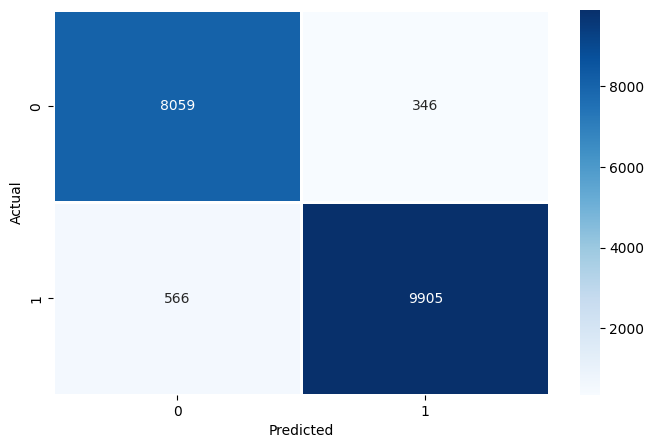

Classification Report
              precision    recall  f1-score   support

           0       0.93      0.96      0.95      8405
           1       0.97      0.95      0.96     10471

    accuracy                           0.95     18876
   macro avg       0.95      0.95      0.95     18876
weighted avg       0.95      0.95      0.95     18876

____________________________________________________________________________________________________


In [43]:
random_f.test(X_test, Y_test)

In [44]:
random_f.save(path="/content/gdrive/MyDrive/Colab Notebooks/Models/Shinkansen/")

Model successfully saved at : /content/gdrive/MyDrive/Colab Notebooks/Models/Shinkansen//RandomForest.pkl


In [45]:
print(random_f)

__________________________________________________
Name: RandomForest
Parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': 22, 'max_features': 15, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 220, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}
Accuracy Score: 0.9996688873289803
Last Testing Score: 0.9516846789574063
Last saved at: /content/gdrive/MyDrive/Colab Notebooks/Models/Shinkansen//RandomForest.pkl
__________________________________________________


In [46]:
predicted_results = random_f.predict(df_test)
predicted_results

Predicting test results using : RandomForest


array([1, 1, 1, ..., 1, 1, 0])

In [47]:
merged_df_test_orig.head()

,ID,Seat_comfort,Seat_Class,Arrival_time_convenient,Catering,Platform_location,Onboardwifi_service,Onboard_entertainment,Online_support,Onlinebooking_Ease,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Travel_Class,Travel_Distance,DepartureDelay_in_Mins,ArrivalDelay_in_Mins
0,3100001,acceptable,Green Car,acceptable,acceptable,manageable,need improvement,excellent,good,excellent,...,excellent,poor,Female,Loyal Customer,36.0,Business travel,Business,532,0.0,0.0
1,3100002,extremely poor,Ordinary,good,poor,manageable,acceptable,poor,acceptable,acceptable,...,excellent,acceptable,Female,disloyal Customer,21.0,Business travel,Business,1425,9.0,28.0
2,3100003,excellent,Ordinary,excellent,excellent,very convinient,excellent,excellent,excellent,need improvement,...,need improvement,excellent,Male,Loyal Customer,60.0,Business travel,Business,2832,0.0,0.0
3,3100004,acceptable,Green Car,excellent,acceptable,very convinient,poor,acceptable,excellent,poor,...,excellent,poor,Female,Loyal Customer,29.0,Personal Travel,Eco,1352,0.0,0.0
4,3100005,excellent,Ordinary,extremely poor,excellent,need improvement,excellent,excellent,excellent,excellent,...,excellent,excellent,Male,disloyal Customer,18.0,Business travel,Business,1610,17.0,0.0


In [48]:
merged_df_test_orig.insert(loc=0, column="Overall_Experience", value=predicted_results)

In [49]:
merged_df_test_orig.head()

,Overall_Experience,ID,Seat_comfort,Seat_Class,Arrival_time_convenient,Catering,Platform_location,Onboardwifi_service,Onboard_entertainment,Online_support,...,Cleanliness,Online_boarding,Gender,CustomerType,Age,TypeTravel,Travel_Class,Travel_Distance,DepartureDelay_in_Mins,ArrivalDelay_in_Mins
0,1,3100001,acceptable,Green Car,acceptable,acceptable,manageable,need improvement,excellent,good,...,excellent,poor,Female,Loyal Customer,36.0,Business travel,Business,532,0.0,0.0
1,1,3100002,extremely poor,Ordinary,good,poor,manageable,acceptable,poor,acceptable,...,excellent,acceptable,Female,disloyal Customer,21.0,Business travel,Business,1425,9.0,28.0
2,1,3100003,excellent,Ordinary,excellent,excellent,very convinient,excellent,excellent,excellent,...,need improvement,excellent,Male,Loyal Customer,60.0,Business travel,Business,2832,0.0,0.0
3,0,3100004,acceptable,Green Car,excellent,acceptable,very convinient,poor,acceptable,excellent,...,excellent,poor,Female,Loyal Customer,29.0,Personal Travel,Eco,1352,0.0,0.0
4,1,3100005,excellent,Ordinary,extremely poor,excellent,need improvement,excellent,excellent,excellent,...,excellent,excellent,Male,disloyal Customer,18.0,Business travel,Business,1610,17.0,0.0


In [50]:
ada_b = ShinkansenModel(name="AdaBoost", model=AdaBoostClassifier(estimator=random_f.model, n_estimators=22, learning_rate=0.1, random_state= 42))


Defining : AdaBoost


In [51]:
ada_b.train(X_train, Y_train)


Training : AdaBoost
Training Accuracy score for : AdaBoost = 0.9998013323973882


In [52]:
ada_b.save(path="/content/gdrive/MyDrive/Colab Notebooks/Models/Shinkansen")

Model successfully saved at : /content/gdrive/MyDrive/Colab Notebooks/Models/Shinkansen/AdaBoost.pkl


Testing : AdaBoost
Testing Accuracy score for : AdaBoost = 0.9504662004662005


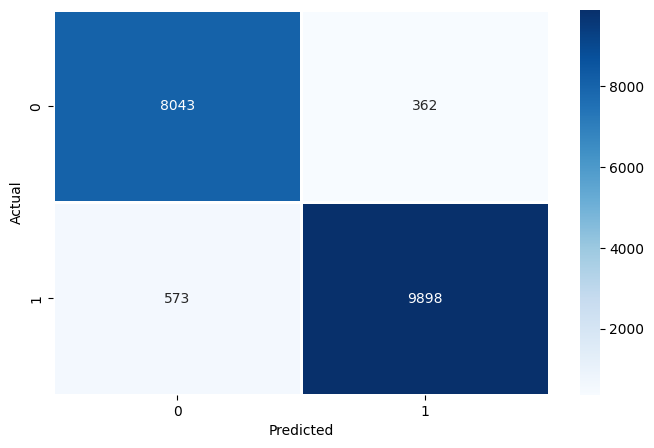

Classification Report
              precision    recall  f1-score   support

           0       0.93      0.96      0.95      8405
           1       0.96      0.95      0.95     10471

    accuracy                           0.95     18876
   macro avg       0.95      0.95      0.95     18876
weighted avg       0.95      0.95      0.95     18876

____________________________________________________________________________________________________


In [53]:
ada_b.test(X_test, Y_test)

In [54]:
ada_b1 = ShinkansenModel(name="AdaBoostDisk")

Defining : AdaBoostDisk


In [55]:
ada_b1.load("/content/gdrive/MyDrive/Colab Notebooks/Models/Shinkansen/AdaBoost.pkl")

AdaBoostClassifier(estimator=RandomForestClassifier(max_depth=22,
                                                    max_features=15,
                                                    n_estimators=220,
                                                    random_state=42),
                   learning_rate=0.1, n_estimators=22, random_state=42)

Testing : AdaBoostDisk
Testing Accuracy score for : AdaBoostDisk = 0.9504662004662005


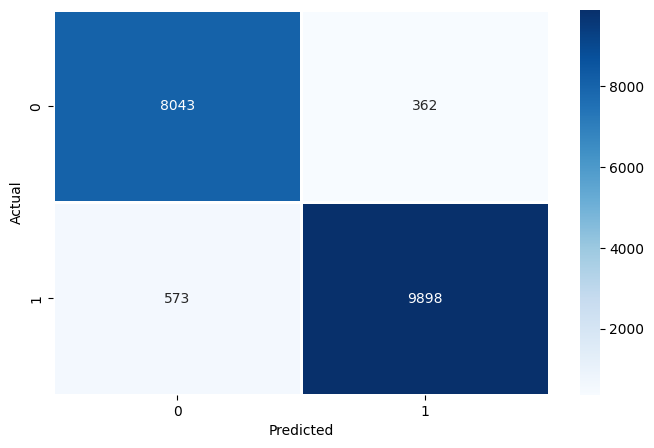

Classification Report
              precision    recall  f1-score   support

           0       0.93      0.96      0.95      8405
           1       0.96      0.95      0.95     10471

    accuracy                           0.95     18876
   macro avg       0.95      0.95      0.95     18876
weighted avg       0.95      0.95      0.95     18876

____________________________________________________________________________________________________


In [56]:
ada_b1.test(X_test, Y_test)

In [ ]:
!pip install autokeras

In [25]:
import autokeras as ak
clf = ak.StructuredDataClassifier(max_trials=10)
history_ak = clf.fit(X_train, Y_train, epochs=100)

Trial 10 Complete [00h 07m 15s]
val_accuracy: 0.9305362105369568

Best val_accuracy So Far: 0.9321269989013672
Total elapsed time: 02h 32m 59s
Epoch 1/100
2360/2360 [==============================] - 15s 6ms/step - loss: 0.2557 - accuracy: 0.8948
Epoch 2/100
2360/2360 [==============================] - 13s 6ms/step - loss: 0.1988 - accuracy: 0.9176
Epoch 3/100
2360/2360 [==============================] - 12s 5ms/step - loss: 0.1757 - accuracy: 0.9265
Epoch 4/100
2360/2360 [==============================] - 13s 6ms/step - loss: 0.1612 - accuracy: 0.9328
Epoch 5/100
2360/2360 [==============================] - 13s 6ms/step - loss: 0.1514 - accuracy: 0.9360
Epoch 6/100
2360/2360 [==============================] - 13s 6ms/step - loss: 0.1438 - accuracy: 0.9394
Epoch 7/100
2360/2360 [==============================] - 12s 5ms/step - loss: 0.1377 - accuracy: 0.9424
Epoch 8/100
2360/2360 [==============================] - 12s 5ms/step - loss: 0.1321 - accuracy: 0.9439
Epoch 9/100
2360/2360 [==